In [2]:
import scanpy as sc
import anndata
import os
import fnmatch
%matplotlib inline
import matplotlib.pylab as plt
import pandas as pd
import numpy as np
#import scrublet as scr
import importlib
import sys
from harmony import harmonize
import seaborn as sns
from matplotlib import rcParams
import math
from scipy import stats
import seaborn as sns
import scipy as sp
import h5py
import warnings
import random
import math
import scvelo as scv
from matplotlib import rcParams
from matplotlib import cm
from matplotlib.colors import LinearSegmentedColormap

In [3]:
#Setting Scanpy figure parameters 
sc.settings.set_figure_params(dpi = 500, color_map = 'RdPu', dpi_save = 500)

In [5]:
adata_allcells = sc.read_h5ad("./adata_Final_for_Reinfection_publication.h5ad")
adata_allcells

AnnData object with n_obs × n_vars = 88360 × 25901
    obs: 'sample', 'DGE_name', 'monkey', 'array number', 'Sample Name', 'Sample type', 'Time point of sampling', 'Infusion before 2nd Mtb infection anti CD4 or IgG', 'Naïve or Primary Infection or Reinfection at sample time', 'Group', 'Group_Detailed', 'Drug Treatment', 'CFU Total ', 'Type of Mtb strain ', 'n_genes', 'n_counts', 'percent_mito', 'percent_ribo', 'percent_hbb', 'predicted_doublets', 'color', 'SubclusteringGroup', 'Subclustering', 'Doublet', 'leiden', 'leiden_lab_orig', 'Doublet_labels', 'Doublet_colors', 'Doublet_str', 'Doublet_int', 'CoarseClustering', 'SubclusteringV2'
    var: 'n_cells', 'Blacklist_Genes', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'CoarseClustering_colors', 'Doublet_colors_colors', 'Doublet_str_colors', 'Group_colors', 'SubclusteringV2_colors', 'Subclustering_colors', 'hvg', 'leiden', 'leiden_colors', 'leiden_lab_orig_colors', 'log1p', 'neighbors', 'pca', 'rank_genes_groups

In [30]:
adata = sc.AnnData(adata_allcells.raw.X, obs=adata_allcells.obs, var=adata_allcells.raw.var, uns=adata_allcells.uns)
adata = adata[adata.obs['CoarseClustering'].isin(['Macrophages']), :]
adata

View of AnnData object with n_obs × n_vars = 22037 × 26030
    obs: 'sample', 'DGE_name', 'monkey', 'array number', 'Sample Name', 'Sample type', 'Time point of sampling', 'Infusion before 2nd Mtb infection anti CD4 or IgG', 'Naïve or Primary Infection or Reinfection at sample time', 'Group', 'Group_Detailed', 'Drug Treatment', 'CFU Total ', 'Type of Mtb strain ', 'n_genes', 'n_counts', 'percent_mito', 'percent_ribo', 'percent_hbb', 'predicted_doublets', 'color', 'SubclusteringGroup', 'Subclustering', 'Doublet', 'leiden', 'leiden_lab_orig', 'Doublet_labels', 'Doublet_colors', 'Doublet_str', 'Doublet_int', 'CoarseClustering', 'SubclusteringV2'
    var: 'n_cells', 'Blacklist_Genes'
    uns: 'CoarseClustering_colors', 'Doublet_colors_colors', 'Doublet_str_colors', 'Group_colors', 'SubclusteringV2_colors', 'Subclustering_colors', 'hvg', 'leiden', 'leiden_colors', 'leiden_lab_orig_colors', 'log1p', 'neighbors', 'pca', 'rank_genes_groups', 'umap'

# Figure 5C,D pseudobulk log2CPM per granuloma (all Macs cells)

In [31]:
def extract_pseudobulk_log2CPM(adata, group_by_col='sample_id', subset=None):
    # subset function: "gate" on CD4+ or CD8+ T cells (similar to Flow cyto)
    if subset:
        if subset == "CD4+":
            adata = adata[adata[:, 'CD4'].X > 0, :]
        elif subset == "CD8A-":
            adata = adata[adata[:, 'CD8A'].X <= 0, :]
        elif subset == "CD8A+":
            adata = adata[adata[:, 'CD8A'].X > 0, :]
        elif subset == "CD4-":
            adata = adata[adata[:, 'CD4'].X <= 0, :]
    
    # convert to df using raw data if available
    if adata.raw:
        df = pd.DataFrame(adata.raw.X.toarray(), columns=adata.raw.var_names, index=adata.obs_names)
    else:
        df = pd.DataFrame(adata.X.toarray(), columns=adata.var_names, index=adata.obs_names)
    
    df[group_by_col] = adata.obs[group_by_col].values
    df['Group'] = adata.obs['Group'].values

    # aggregate counts by sample and group
    aggregated_counts = df.groupby([group_by_col, 'Group']).sum().reset_index()
    
    # calculate log2(CPM+1)
    total_counts_per_sample = aggregated_counts.iloc[:, 2:].sum(axis=1).to_numpy()  # Skip the first two columns
    cpm = (aggregated_counts.iloc[:, 2:] / total_counts_per_sample[:, None]) * 1e6
    log2cpm = np.log2(cpm + 1)
    
    log2cpm[group_by_col] = aggregated_counts[group_by_col]
    log2cpm['Group'] = aggregated_counts['Group']
    
    return log2cpm

def filter_genes_log2cpm(log2cpm_df, genes_list, group_by_col):
    # keep specified genes, along with 'Group' and group_by_col
    filtered_log2cpm = log2cpm_df[genes_list + ['Group', group_by_col]]
    return filtered_log2cpm



In [ ]:
genes = ["CXCL8",'CXCL9',"CXCL10","CXCL11","CXCL12",
         "IL2RA","CSF2RB","TNF","CCR7","CD5L","CCL3",
              "IL1A","IL1B","VEGFA","TGFBI",
              "ISG15","ISG20","MX1","IFIT3",
              "SLAMF7" ,"CD40","IDO1" ,"CD80","SLAMF8" ,"CARD16","CD274"]
genes = ["IL6","IL10","IL13","IL15","IL18","IL27","IL6ST","IL1R2", "LYST","IRF8","TLR5","TLR2",
            "TLR4","TLR6","TLR7","TLR8","NOD1","COCH","SLC11A1","SERPINB9","NOD2","BCL3","GSDMD",
    "PPARG","FABP4","CD36","RETN","SLC1A5","CMBL","DHRS7","PDLIM1","HMOX2","CAT","SOD1","GSR","TXN","MGST1"]

In [36]:
genes = ["IL6","IL10","IL13","IL15","IL18","IL27","IL6ST","IL1R2", "LYST","IRF8","TLR5","TLR2",
            "TLR4","TLR6","TLR7","TLR8","NOD1","COCH","SLC11A1","SERPINB9","NOD2","BCL3","GSDMD",
    "PPARG","FABP4","CD36","RETN","SLC1A5","CMBL","DHRS7","PDLIM1","HMOX2","CAT","SOD1","GSR","TXN","MGST1"]
# extract pseudobulk log2CPM values
all_log2cpm_values = extract_pseudobulk_log2CPM(adata, group_by_col='array number')
# filter log2CPM values for the genes of interest
filtered_log2cpm_values = filter_genes_log2cpm(all_log2cpm_values, genes, group_by_col='array number')
filtered_log2cpm_values


,IL6,IL10,IL13,IL15,IL18,IL27,IL6ST,IL1R2,LYST,IRF8,...,DHRS7,PDLIM1,HMOX2,CAT,SOD1,GSR,TXN,MGST1,Group,array number
0,4.448210,4.743038,0.000000,3.889242,5.732730,0.498216,7.640986,3.002149,6.646712,7.547066,...,8.243800,4.059504,7.592480,8.478778,7.345953,6.432634,8.388438,1.796929,IgG,12518_Array2
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Naïve,12518_Array2
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,antiCD4,12518_Array2
3,3.272079,4.897034,1.131458,4.508377,5.793170,1.506058,7.800395,4.229108,6.777257,8.248977,...,8.251029,6.387268,8.480855,8.514129,7.387047,6.595401,8.330805,3.063730,IgG,12518_Array3
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Naïve,12518_Array3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
94,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Naïve,14218_Array11
95,4.829619,5.055997,1.132804,4.447259,5.131579,2.137376,8.122232,3.159052,7.250890,7.706759,...,8.165730,6.167017,8.080564,8.490127,7.059033,5.260631,7.736113,3.079854,antiCD4,14218_Array11
96,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,IgG,14218_Array12
97,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Naïve,14218_Array12


In [37]:
print("Unique groups in the pseudobulk matrix:")
print(filtered_log2cpm_values['Group'].unique())

Unique groups in the pseudobulk matrix:
['IgG', 'Naïve', 'antiCD4']
Categories (3, object): ['IgG', 'Naïve', 'antiCD4']


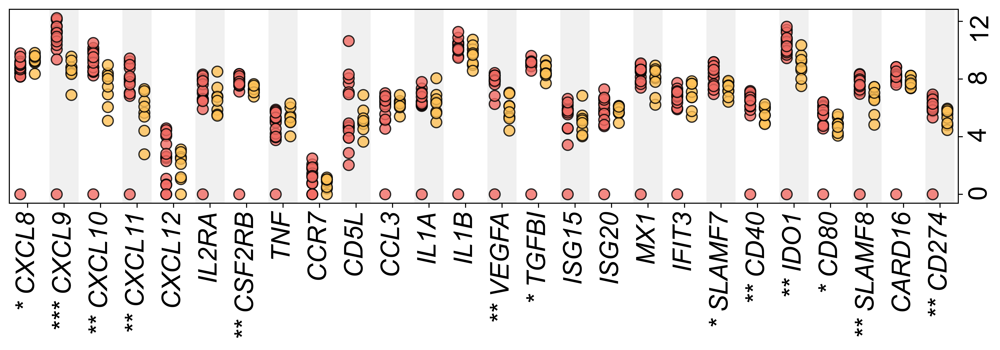

P-values:
CXCL8: 0.020137
CXCL9: 0.000995
CXCL10: 0.003676
CXCL11: 0.002985
CXCL12: 0.477675
IL2RA: 0.220031
CSF2RB: 0.003676
TNF: 0.272490
CCR7: 0.146399
CD5L: 1.000000
CCL3: 0.948533
IL1A: 0.605577
IL1B: 0.106583
VEGFA: 0.001946
TGFBI: 0.038867
ISG15: 0.137638
ISG20: 0.605577
MX1: 0.438578
IFIT3: 0.651378
SLAMF7: 0.020137
CD40: 0.009823
IDO1: 0.002985
CD80: 0.028186
SLAMF8: 0.003676
CARD16: 0.052808
CD274: 0.006706


In [34]:
from scipy.stats import ranksums
import matplotlib.patches as patches
#Main Figure 5
def plot_strip_log2cpm(log2cpm_df, genes_list, group_col, save=None):
    fig, ax = plt.subplots(figsize=(11, 4))
    
    dodge = 0.2  
    stars = []  
    p_values = {}
    
    for idx, gene in enumerate(genes_list):
        anticd4_vals = log2cpm_df.loc[log2cpm_df[group_col] == "antiCD4", gene].dropna().values
        igg_vals = log2cpm_df.loc[log2cpm_df[group_col] == "IgG", gene].dropna().values
        
        ax.scatter([idx - dodge]*len(anticd4_vals), anticd4_vals, color=reinfection_palette["antiCD4"], s=70, edgecolors='black', alpha=0.8)
        ax.scatter([idx + dodge]*len(igg_vals), igg_vals, color=reinfection_palette["IgG"], s=70, edgecolors='black', alpha=0.8)
        
        # Wilcoxon rank-sum test
        _, p_value = ranksums(anticd4_vals, igg_vals)
        p_values[gene] = p_value
        
        # define significance levels/what will be annotated on fig
        if p_value < 0.001:
            stars.append("***")
        elif p_value < 0.01:
            stars.append("**")
        elif p_value < 0.05:
            stars.append("*")
        else:
            stars.append("")
    
    for idx in range(1, len(genes_list), 2):
        ax.add_patch(patches.Rectangle((idx-0.4, ax.get_ylim()[0]), 0.8, ax.get_ylim()[1] - ax.get_ylim()[0], facecolor="#f0f0f0", edgecolor='none', zorder=-20))
    
    ax.grid(False)  
    ax.set_xlim(-0.5, len(genes_list)-0.5)  
    ax.set_xticks(range(len(genes_list)))
    ax.set_xticklabels([f"{star} {gene}" for star, gene in zip(stars, genes_list)], rotation=90, fontstyle='italic')
    plt.xticks(fontsize=20)
    
    y_min, y_max = ax.get_ylim()
    ax.yaxis.set_major_locator(plt.MaxNLocator(4))
    
    ax.yaxis.tick_right()
    ax.yaxis.set_tick_params(rotation=90)
    plt.yticks(fontsize=20)
    plt.tight_layout()
    
    if save:
        plt.savefig(save, dpi=1000, bbox_inches='tight', transparent=True)
    plt.show()
    
    # Print p-values
    print("P-values:")
    for gene, p_value in p_values.items():
        print(f"{gene}: {p_value:.6f}")
    
    return p_values

p_values = plot_strip_log2cpm(filtered_log2cpm_values, genes, 'Group', save="./Mac_aCD4_IgG_CPM_StripPlot_genes_for_Publication.png")


In [ ]:
# Supplemental Figure Associated with Figure 5
def plot_strip_log2cpm(log2cpm_df, genes_list, group_col, save=None):
    fig, ax = plt.subplots(figsize=(18, 4))
    
    dodge = 0.2  
    stars = []  
    p_values = {}
    
    for idx, gene in enumerate(genes_list):
        anticd4_vals = log2cpm_df.loc[log2cpm_df[group_col] == "antiCD4", gene].dropna().values
        igg_vals = log2cpm_df.loc[log2cpm_df[group_col] == "IgG", gene].dropna().values
        
        ax.scatter([idx - dodge]*len(anticd4_vals), anticd4_vals, color=reinfection_palette["antiCD4"], s=70, edgecolors='black', alpha=0.8)
        ax.scatter([idx + dodge]*len(igg_vals), igg_vals, color=reinfection_palette["IgG"], s=70, edgecolors='black', alpha=0.8)
        
        # Wilcoxon rank-sum test
        _, p_value = ranksums(anticd4_vals, igg_vals)
        p_values[gene] = p_value
        
        # define significance levels/what will be annotated on fig
        if p_value < 0.001:
            stars.append("***")
        elif p_value < 0.01:
            stars.append("**")
        elif p_value < 0.05:
            stars.append("*")
        else:
            stars.append("")
    
    for idx in range(1, len(genes_list), 2):
        ax.add_patch(patches.Rectangle((idx-0.4, ax.get_ylim()[0]), 0.8, ax.get_ylim()[1] - ax.get_ylim()[0], facecolor="#f0f0f0", edgecolor='none', zorder=-20))
    
    ax.grid(False)  
    ax.set_xlim(-0.5, len(genes_list)-0.5)  
    ax.set_xticks(range(len(genes_list)))
    ax.set_xticklabels([f"{star} {gene}" for star, gene in zip(stars, genes_list)], rotation=90, fontstyle='italic')
    plt.xticks(fontsize=20)
    
    y_min, y_max = ax.get_ylim()
    ax.yaxis.set_major_locator(plt.MaxNLocator(4))
    
    ax.yaxis.tick_right()
    ax.yaxis.set_tick_params(rotation=90)
    plt.yticks(fontsize=20)
    plt.tight_layout()
    
    if save:
        plt.savefig(save, dpi=1000, bbox_inches='tight', transparent=True)
    plt.show()
    
    # Print p-values
    print("P-values:")
    for gene, p_value in p_values.items():
        print(f"{gene}: {p_value:.6f}")
    
    return p_values

p_values = plot_strip_log2cpm(filtered_log2cpm_values, genes, 'Group', save="./Mac_Supplemental_aCD4_IgG_CPM_StripPlot_genes_for_Publication.png")

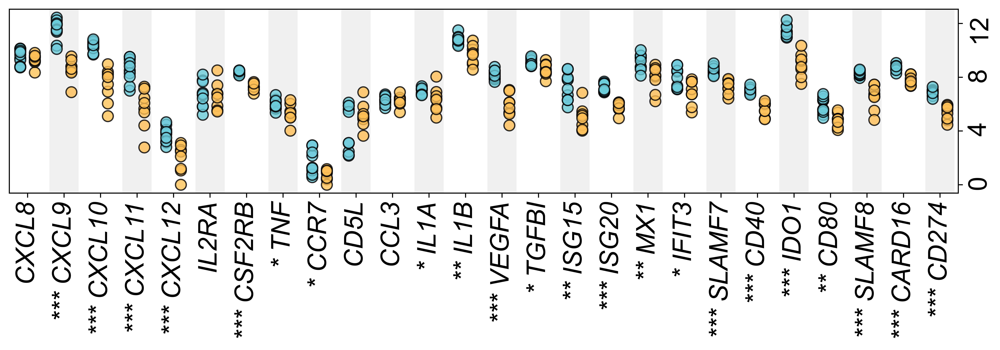

P-values:
CXCL8: 0.374259
CXCL9: 0.000379
CXCL10: 0.000379
CXCL11: 0.000734
CXCL12: 0.000734
IL2RA: 0.789810
CSF2RB: 0.000379
TNF: 0.026330
CCR7: 0.032969
CD5L: 0.533964
CCL3: 0.858955
IL1A: 0.026330
IL1B: 0.001872
VEGFA: 0.000379
TGFBI: 0.012851
ISG15: 0.001381
ISG20: 0.000379
MX1: 0.004465
IFIT3: 0.016439
SLAMF7: 0.000379
CD40: 0.000379
IDO1: 0.000379
CD80: 0.001872
SLAMF8: 0.000379
CARD16: 0.000379
CD274: 0.000379


In [35]:
#Main Figure 5
def plot_strip_log2cpm(log2cpm_df, genes_list, group_col, save=None):
    fig, ax = plt.subplots(figsize=(11, 4))
    
    dodge = 0.2  
    stars = []  
    p_values = {}
    
    for idx, gene in enumerate(genes_list):
        anticd4_vals = log2cpm_df.loc[log2cpm_df[group_col] == "Naïve", gene].dropna().values
        igg_vals = log2cpm_df.loc[log2cpm_df[group_col] == "IgG", gene].dropna().values
        
        ax.scatter([idx - dodge]*len(anticd4_vals), anticd4_vals, color=reinfection_palette["Naïve"], s=70, edgecolors='black', alpha=0.8)
        ax.scatter([idx + dodge]*len(igg_vals), igg_vals, color=reinfection_palette["IgG"], s=70, edgecolors='black', alpha=0.8)
        
        # Wilcoxon rank-sum test
        _, p_value = ranksums(anticd4_vals, igg_vals)
        p_values[gene] = p_value
        
        # define significance levels/what will be annotated on fig
        if p_value < 0.001:
            stars.append("***")
        elif p_value < 0.01:
            stars.append("**")
        elif p_value < 0.05:
            stars.append("*")
        else:
            stars.append("")
    
    for idx in range(1, len(genes_list), 2):
        ax.add_patch(patches.Rectangle((idx-0.4, ax.get_ylim()[0]), 0.8, ax.get_ylim()[1] - ax.get_ylim()[0], facecolor="#f0f0f0", edgecolor='none', zorder=-20))
    
    ax.grid(False)  
    ax.set_xlim(-0.5, len(genes_list)-0.5)  
    ax.set_xticks(range(len(genes_list)))
    ax.set_xticklabels([f"{star} {gene}" for star, gene in zip(stars, genes_list)], rotation=90, fontstyle='italic')
    plt.xticks(fontsize=20)
    
    y_min, y_max = ax.get_ylim()
    ax.yaxis.set_major_locator(plt.MaxNLocator(4))
    
    ax.yaxis.tick_right()
    ax.yaxis.set_tick_params(rotation=90)
    plt.yticks(fontsize=20)
    plt.tight_layout()
    
    if save:
        plt.savefig(save, dpi=1000, bbox_inches='tight', transparent=True)
    plt.show()
    
    # Print p-values
    print("P-values:")
    for gene, p_value in p_values.items():
        print(f"{gene}: {p_value:.6f}")
    
    return p_values

p_values = plot_strip_log2cpm(filtered_log2cpm_values, genes, 'Group', save="./Mac_Naïve_IgG_CPM_StripPlot_genes_for_Publication.png")

In [ ]:
# Supplemental Figure Associated with Figure 5
def plot_strip_log2cpm(log2cpm_df, genes_list, group_col, save=None):
    fig, ax = plt.subplots(figsize=(18, 4))
    
    dodge = 0.2  
    stars = []  
    p_values = {}
    
    for idx, gene in enumerate(genes_list):
        anticd4_vals = log2cpm_df.loc[log2cpm_df[group_col] == "Naïve", gene].dropna().values
        igg_vals = log2cpm_df.loc[log2cpm_df[group_col] == "IgG", gene].dropna().values
        
        ax.scatter([idx - dodge]*len(anticd4_vals), anticd4_vals, color=reinfection_palette["Naïve"], s=70, edgecolors='black', alpha=0.8)
        ax.scatter([idx + dodge]*len(igg_vals), igg_vals, color=reinfection_palette["IgG"], s=70, edgecolors='black', alpha=0.8)
        
        # Wilcoxon rank-sum test
        _, p_value = ranksums(anticd4_vals, igg_vals)
        p_values[gene] = p_value
        
        # define significance levels/what will be annotated on fig
        if p_value < 0.001:
            stars.append("***")
        elif p_value < 0.01:
            stars.append("**")
        elif p_value < 0.05:
            stars.append("*")
        else:
            stars.append("")
    
    for idx in range(1, len(genes_list), 2):
        ax.add_patch(patches.Rectangle((idx-0.4, ax.get_ylim()[0]), 0.8, ax.get_ylim()[1] - ax.get_ylim()[0], facecolor="#f0f0f0", edgecolor='none', zorder=-20))
    
    ax.grid(False)  
    ax.set_xlim(-0.5, len(genes_list)-0.5)  
    ax.set_xticks(range(len(genes_list)))
    ax.set_xticklabels([f"{star} {gene}" for star, gene in zip(stars, genes_list)], rotation=90, fontstyle='italic')
    plt.xticks(fontsize=20)
    
    y_min, y_max = ax.get_ylim()
    ax.yaxis.set_major_locator(plt.MaxNLocator(4))
    
    ax.yaxis.tick_right()
    ax.yaxis.set_tick_params(rotation=90)
    plt.yticks(fontsize=20)
    plt.tight_layout()
    
    if save:
        plt.savefig(save, dpi=1000, bbox_inches='tight', transparent=True)
    plt.show()
    
    # Print p-values
    print("P-values:")
    for gene, p_value in p_values.items():
        print(f"{gene}: {p_value:.6f}")
    
    return p_values

p_values = plot_strip_log2cpm(filtered_log2cpm_values, genes, 'Group', save="./Mac_Supplemental_Naïve_IgG_CPM_StripPlot_genes_for_Publication.png")

# Figure 5 GSEApy-Macrophages 

In [23]:
import gseapy as gp
#NOTE: when running GSEA-py the user will need to change the experimental group (Naive or antiCD4) for each analysis
adata_raw = sc.AnnData(adata_allcells.raw.X, obs=adata_allcells.obs, var=adata_allcells.raw.var, uns=adata_allcells.uns)
adata_raw = adata_raw[adata_raw.obs['CoarseClustering'].isin(['Macrophages']), :]
adata_raw = adata_raw[adata_raw.obs['Group'].isin(["Naïve","IgG"]), :] # change experimental group here (can swap to antiCD4)
adata_raw.raw = adata_raw.copy()
# keep blacklist genes from vars (they are stored in .raw so still accessible)
adata_raw = adata_raw[:,~adata_raw.var['Blacklist_Genes']]
sc.pp.normalize_per_cell(adata_raw, counts_per_cell_after=1e4)
sc.pp.log1p(adata_raw)
sc.pp.highly_variable_genes(adata_raw, n_top_genes=2000)
adata_raw.var['highly_variable'].value_counts()
adata_raw

AnnData object with n_obs × n_vars = 12850 × 25901
    obs: 'sample', 'DGE_name', 'monkey', 'array number', 'Sample Name', 'Sample type', 'Time point of sampling', 'Infusion before 2nd Mtb infection anti CD4 or IgG', 'Naïve or Primary Infection or Reinfection at sample time', 'Group', 'Group_Detailed', 'Drug Treatment', 'CFU Total ', 'Type of Mtb strain ', 'n_genes', 'n_counts', 'percent_mito', 'percent_ribo', 'percent_hbb', 'predicted_doublets', 'color', 'SubclusteringGroup', 'Subclustering', 'Doublet', 'leiden', 'leiden_lab_orig', 'Doublet_labels', 'Doublet_colors', 'Doublet_str', 'Doublet_int', 'CoarseClustering', 'SubclusteringV2'
    var: 'n_cells', 'Blacklist_Genes', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'CoarseClustering_colors', 'Doublet_colors_colors', 'Doublet_str_colors', 'Group_colors', 'SubclusteringV2_colors', 'Subclustering_colors', 'hvg', 'leiden', 'leiden_colors', 'leiden_lab_orig_colors', 'log1p', 'neighbors', 'pca', 'rank_genes_groups

In [24]:
adata_raw.layers['lognorm'] = adata_raw.X

In [25]:
adata_raw

AnnData object with n_obs × n_vars = 12850 × 25901
    obs: 'sample', 'DGE_name', 'monkey', 'array number', 'Sample Name', 'Sample type', 'Time point of sampling', 'Infusion before 2nd Mtb infection anti CD4 or IgG', 'Naïve or Primary Infection or Reinfection at sample time', 'Group', 'Group_Detailed', 'Drug Treatment', 'CFU Total ', 'Type of Mtb strain ', 'n_genes', 'n_counts', 'percent_mito', 'percent_ribo', 'percent_hbb', 'predicted_doublets', 'color', 'SubclusteringGroup', 'Subclustering', 'Doublet', 'leiden', 'leiden_lab_orig', 'Doublet_labels', 'Doublet_colors', 'Doublet_str', 'Doublet_int', 'CoarseClustering', 'SubclusteringV2'
    var: 'n_cells', 'Blacklist_Genes', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'CoarseClustering_colors', 'Doublet_colors_colors', 'Doublet_str_colors', 'Group_colors', 'SubclusteringV2_colors', 'Subclustering_colors', 'hvg', 'leiden', 'leiden_colors', 'leiden_lab_orig_colors', 'log1p', 'neighbors', 'pca', 'rank_genes_groups

In [26]:
adata_raw.obs.groupby('Subclustering')['Group'].value_counts()

Subclustering                                 
C1QB$^{hi}$, C1QA$^{hi}$ Mφ              Naïve     915
                                         IgG       487
CXCL9$^{hi}$, IDO1$^{hi}$ Mφ             Naïve    2321
                                         IgG       336
FABP4$^{hi}$, MCEMP1$^{hi}$ Alveolar Mφ  Naïve    2438
                                         IgG      2116
LGALS3$^{hi}$, FN1$^{hi}$ Mφ             Naïve     546
                                         IgG        14
S100A4$^{hi}$, CFP$^{hi}$ Monocytes      Naïve    1286
                                         IgG       436
THBS1$^{hi}$, FCN1$^{hi}$ Mφ             Naïve    1909
                                         IgG        46
Name: Group, dtype: int64

In [27]:
adata_raw.obs['Group'] = pd.Categorical(adata_raw.obs['Group'], categories=["IgG", "Naïve"], ordered=True)
indices = adata_raw.obs.sort_values(['Subclustering', 'Group']).index
adata_raw = adata_raw[indices,:]

In [28]:
import time
t1 = time.time()
res = gp.gsea(data=adata_raw.to_df().T, 
        gene_sets="MSigDB_Hallmark_2020",
        cls=adata_raw.obs.Group,
        permutation_num=1000,
        permutation_type='phenotype',
        outdir=None,
        method='s2n', # signal_to_noise
        threads= 16)
t2=time.time()
print(t2-t1)

423.4542100429535


In [29]:
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)
df=pd.DataFrame(res.res2d.head(100))
df.to_csv("./Excel_Sheet_Supplementary_Info/Excel_logCPM/Monocyte-derived/_.csv")
#df[df['Term'].str.contains('Adipogenesis')]

In [89]:
res.res2d["Lead_genes"][6]

'CXCL10;TNFAIP3;LAT2;PSMB8;IL10RA;CLEC4A;F13A1;IL1B;TNFRSF1B;BIRC3;GFPT2;PPP1R15A;TRAF1;EPB41L3;LCP1;SCN1B;EREG;G0S2;NIN;MAP3K1;TMEM176A;CMKLR1;ERO1A;PLAUR;KLF4;TLR8;TMEM176B;AKT2;ITGB2;PRDM1;PTGS2;TRIB1;GYPC;IRF8;DOCK2;RBM4;SATB1;IKZF1;PLAU;MMP9;ADAM8;CCND2;ID2;ALDH1A2;USP12;CBL;INHBA;SDCCAG8;PDCD1LG2;STRN;ST6GAL1;GPRC5B;ETV5;SERPINA3;IL1RL2;EPHB2;RGS16;C3AR1;FUCA1;FBXO4;ALDH1A3;SPP1;PLEK2;CTSS;HBEGF;ANGPTL4;DUSP6;PECAM1;CCL20;BPGM'

In [ ]:
i = 1
genes = res.res2d.Lead_genes.iloc[i].split(";")
ax = gp.heatmap(df = res.heatmat.loc[genes],
           z_score=None,
           title=res.res2d.Term.iloc[i],
           figsize=(6,5),
           cmap=plt.cm.viridis,
           xticklabels=False)

In [ ]:
term = res.res2d.Term
gp.gseaplot(res.ranking, term=term[i], **res.results[term[i]])
#axs = res.plot(terms=term[:1])

In [ ]:
i=3
term = res.res2d.Term
gp.gseaplot(res.ranking, term=term[i], **res.results[term[i]])
#axs = res.plot(terms=term[0])

In [94]:
# find degs
sc.tl.rank_genes_groups(adata_raw,
                        groupby='Group',
                        use_raw=False,
                        layer='lognorm',
                        method='wilcoxon',
                        groups=["IgG"],
                        reference='Naïve')

In [95]:
# get deg result
result = adata_raw.uns['rank_genes_groups']
groups = result['names'].dtype.names
degs = pd.DataFrame(
    {group + '_' + key: result[key][group]
    for group in groups for key in ['names','scores', 'pvals','pvals_adj','logfoldchanges']})

In [96]:
degs.head()


,IgG_names,IgG_scores,IgG_pvals,IgG_pvals_adj,IgG_logfoldchanges
0,LOC102140782,46.847576,0.0,0.0,1.269039
1,FABP4,40.293911,0.0,0.0,4.327402
2,CRIP1,40.252392,0.0,0.0,1.921350
3,CHIT1,39.150513,0.0,0.0,3.133313
4,LOC102140002,37.868122,0.0,0.0,1.189301


In [97]:
# subset up or down regulated genes
degs_sig = degs[degs.IgG_pvals_adj < 0.05]
degs_up = degs_sig[degs_sig.IgG_logfoldchanges > 0]
degs_dw = degs_sig[degs_sig.IgG_logfoldchanges < 0]

In [98]:
degs_up.shape


(1879, 5)

In [99]:
degs_dw.shape


(3305, 5)

In [100]:
# Enricr API
enr_up = gp.enrichr(degs_up.IgG_names,
                    gene_sets='MSigDB_Hallmark_2020',
                    outdir=None)


In [ ]:
# dotplot
gp.dotplot(enr_up.res2d, figsize=(3,5), title="Up", cmap = "RdBu_r")
plt.show()

In [1]:
enr_dw = gp.enrichr(degs_dw.IgG_names,
                    gene_sets='MSigDB_Hallmark_2020',
                    outdir=None)

NameError: name 'gp' is not defined

In [ ]:
gp.dotplot(enr_dw.res2d,
           figsize=(3,5),
           title="Down",
           cmap = "RdBu_r",
           size=5)
plt.show()

In [ ]:
gp.dotplot(enr_dw.res2d,
           figsize=(3,5),
           title="Down",
           cmap = "RdBu_r",
           size=5)
plt.show()

In [105]:
# concat results
enr_up.res2d['UP_DW'] = "UP"
enr_dw.res2d['UP_DW'] = "DOWN"
enr_res = pd.concat([enr_up.res2d.head(8), enr_dw.res2d.head(8)])

In [ ]:
enr_dw.res2d

In [ ]:
enr_up.res2d

#NOTE: Use caution when using GSEAPY as the source code is not correctly annotated (they are plotting fraction of genes in geneset but they have annotated it as %)
#we resolved this issue for our publication images and annotated it as fraction of genes

In [ ]:
# aCD4 vs IgG
ax = gp.dotplot(enr_res,figsize=(3,5),
                x='UP_DW',
                x_order = ["UP","DOWN"],
                title="",
                cmap = "RdBu_r",
                size=3,
                show_ring=True)
ax.set_xlabel("")
ax.grid(False)
plt.savefig('./Figure5/Associated_Supplemental/Figure5_GSEA_Hallmark_IgGvsaCD4.png',bbox_inches="tight",dpi=1000,transparent=True)


In [ ]:
# naive vs igg
ax = gp.dotplot(enr_res,figsize=(3,5),
                x='UP_DW',
                x_order = ["UP","DOWN"],
                title="",
                cmap = "RdBu_r",
                size=5,
                show_ring=True,
               top_term=15)
ax.set_xlabel("")
ax.grid(False)

plt.savefig('./Figure5/Associated_Supplemental/Figure5_GSEA_Hallmark_IgGvsNaive.png',bbox_inches="tight",dpi=1000,transparent=True)


# Supplemental Figure Related to Figure 5

In [20]:
import decoupler as dc
import gseapy as gp
adata_raw = sc.AnnData(adata_allcells.raw.X, obs=adata_allcells.obs, var=adata_allcells.raw.var, uns=adata_allcells.uns)
adata_raw_filtered = adata_raw[adata_raw.obs['CoarseClustering'].isin(['Macrophages']), :]
#adata_raw_filtered = adata_raw_filtered[adata_raw_filtered.obs['Group'].isin(["antiCD4","IgG"]), :]
adata_raw_filtered.raw = adata_raw_filtered.copy()
# keep blacklist genes from vars (they are stored in .raw so still accessible)
#adata_raw = adata_raw[:,~adata_raw.var['Blacklist_Genes']]
sc.pp.normalize_per_cell(adata_raw_filtered, counts_per_cell_after=1e4)
sc.pp.log1p(adata_raw_filtered)
sc.pp.highly_variable_genes(adata_raw_filtered, n_top_genes=2000)
adata_raw_filtered.var['highly_variable'].value_counts()
adata_raw_filtered.layers['lognorm'] = adata_raw_filtered.X
adata_raw_filtered
#adata_raw_filtered.obs['Group'] = pd.Categorical(adata_raw_filtered.obs['Group'], categories=["IgG", "antiCD4"], ordered=True)
#indices = adata_raw_filtered.obs.sort_values(['Subclustering', 'Group']).index
#adata_raw_filtered = adata_raw_filtered[indices,:]
#adata_raw=adata_raw_filtered
adata_raw_filtered
adata=adata_raw_filtered.copy()


In [25]:
msigdb = dc.get_resource('MSigDB')
msigdb
msigdb_kegg = msigdb[msigdb['collection']=='go_molecular_function']
# remove duplicated entries
msigdb_kegg = msigdb_kegg[~msigdb_kegg.duplicated(['geneset', 'genesymbol'])]
msigdb_kegg
dc.run_ora(
    mat=adata,
    net=msigdb_kegg,
    source='geneset',
    target='genesymbol',
    verbose=True
)
acts = dc.get_acts(adata, obsm_key='ora_estimate')
# we need to remove inf and set to the maximum value observed
acts_v = acts.X.ravel()
max_e = np.nanmax(acts_v[np.isfinite(acts_v)])
acts.X[~np.isfinite(acts.X)] = max_e
acts

466 features of mat are empty, they will be removed.
Running ora on mat with 22037 samples and 25564 targets for 1599 sources.


100%|█████████████████████████████████████| 22037/22037 [05:11<00:00, 70.78it/s]


AnnData object with n_obs × n_vars = 22037 × 1599
    obs: 'sample', 'DGE_name', 'monkey', 'array number', 'Sample Name', 'Sample type', 'Time point of sampling', 'Infusion before 2nd Mtb infection anti CD4 or IgG', 'Naïve or Primary Infection or Reinfection at sample time', 'Group', 'Group_Detailed', 'Drug Treatment', 'CFU Total ', 'Type of Mtb strain ', 'n_genes', 'n_counts', 'percent_mito', 'percent_ribo', 'percent_hbb', 'predicted_doublets', 'color', 'SubclusteringGroup', 'Subclustering', 'Doublet', 'leiden', 'leiden_lab_orig', 'Doublet_labels', 'Doublet_colors', 'Doublet_str', 'Doublet_int', 'CoarseClustering', 'SubclusteringV2'
    uns: 'CoarseClustering_colors', 'Doublet_colors_colors', 'Doublet_str_colors', 'Group_colors', 'SubclusteringV2_colors', 'Subclustering_colors', 'hvg', 'leiden', 'leiden_colors', 'leiden_lab_orig_colors', 'log1p', 'neighbors', 'pca', 'rank_genes_groups', 'umap', 'dendrogram_SubclusteringV2'
    obsm: 'ora_estimate', 'ora_pvals'

In [ ]:
df = dc.rank_sources_groups(acts, groupby='SubclusteringV2', reference='rest', method='t-test_overestim_var')
df

In [ ]:
n_markers = 15
source_markers = df.groupby('group').head(n_markers).groupby('group')['names'].apply(lambda x: list(x)).to_dict()
source_markers

In [28]:
sc.pl.matrixplot(acts, source_markers, 'SubclusteringV2', dendrogram=True, standard_scale='var',
                 colorbar_title='Z-scaled scores', cmap='RdBu_r')#,save="decoupler_GOmolecular_pathway_Macrophges.png")